In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Importing the required Libraries
import pandas as pd
import numpy as np
import seaborn as sns
sns.set_style('whitegrid')
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn

# Librosa (the mother of audio files)
import librosa, IPython
import librosa.display
import IPython.display
import warnings
warnings.filterwarnings('ignore')

seed = 12
np.random.seed(seed)

### **GTZAN Genre Collection**
The dataset used in this project is the GTZAN Genre Collection dataset that contains audio files of 30s each that belong to either of the 10 genres specified below. Each genre contains approximately 1000 audios.

**Genres:** Blues, Classical, Country, Disco, Hip-hop, Jazz, Metal, Pop, Reggae, Rock


In [41]:
genre_list = ["blues","classical","country","disco","hiphop","jazz","metal","pop","reggae","rock"]
hop_length = 512

n_fft = 2048

In [42]:
path_audio_files = '/content/drive/MyDrive/ML/Final_Project/Data/genres_original/'
for genre in genre_list:
    print(genre)
    
    # Reading the first audio file of each class
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    
    display(IPython.display.Audio(data, rate = sampling_rate))

blues


classical


country


disco


hiphop


jazz


metal


pop


reggae


rock


# **Data Preprocessing, Data Visualization & EDA**

To analyze these audio files, there are two approaches that can be taken:
1. Audio -> Numerical Values
2. Audio -> Image

With the initial 1000 audio files, we built a .csv file that had all the features (rmse, spectral centroid, rolloff etc) in terms of numbers using librosa library.

As we built this file, we realized that the anount of data we had wasn't large enough to obtain good results.

Alongside the 1000 audio files, the dataset also had two additional .csv files that contained the "numerical features" of the audio.

To increase the amount of data, each audio file was split into 3s each, thereby increasing the dataset by 10 times. This increased the amount of data from 1000 to 10,000. This was one of the other .csv files that we used in this project.

Once we had this data, we used the encoding technique to convert the labels to integers.

In [36]:
#loading the data
df = pd.read_csv("https://raw.githubusercontent.com/purav-parekh/music-genre-classification/main/features_3_sec.csv") 
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [ ]:
print("Dataset has",df.shape)
print("Count of Positive and Negative samples")
df.label.value_counts().reset_index()

Dataset has (9990, 60)
Count of Positive and Negative samples


,index,label
0,blues,1000
1,jazz,1000
2,metal,1000
3,pop,1000
4,reggae,1000
5,disco,999
6,classical,998
7,hiphop,998
8,rock,998
9,country,997


In [7]:
#getting a sample file and playing
audio_fp = '/content/drive/MyDrive/ML/Final_Project/Data/genres_original/blues/blues.00000.wav'
audio_data, sr = librosa.load(audio_fp)
audio_data, _ = librosa.effects.trim(audio_data)

print('audio_data:', audio_data, '\n')
print('audio_data shape:', np.shape(audio_data), '\n')
print('Sample Rate (KHz):', sr, '\n')

print('Check Len of Audio:', 661794/22050)

audio_data: [ 0.00732422  0.01660156  0.00762939 ... -0.05560303 -0.06106567
 -0.06417847] 

audio_data shape: (661794,) 

Sample Rate (KHz): 22050 

Check Len of Audio: 30.013333333333332


In [9]:
audio, _ = librosa.effects.trim(audio_data)

print('Audio File:', audio, '\n')
print('Audio File shape:', np.shape(audio))

Audio File: [ 0.00732422  0.01660156  0.00762939 ... -0.05560303 -0.06106567
 -0.06417847] 

Audio File shape: (661794,)


## Waveform

A waveform is a basic visual representation of an audio signal that reflects how an amplitude changes over time. The graph displays the time on the horizontal (X) axis and the amplitude on the vertical (Y) axis.

Sampling rate is defined as the avg number of samples obtained in 1 second. It is used while converting the continuous data to a discrete data. Here, the sampling rate is 22050 samples, i.e, in 1 second 22050 samples are taken.

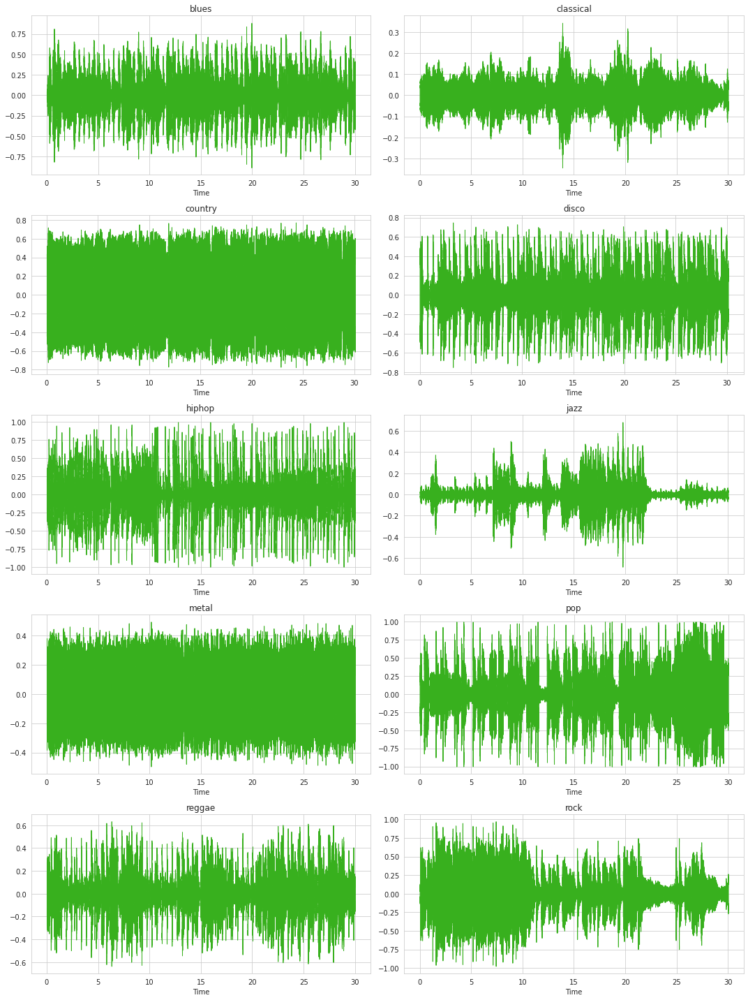

In [43]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    # Reading the first audio file
    data,sampling_rate = librosa.load(path_audio_files + genre + "/" + genre + ".00000.wav")
    librosa.display.waveshow(y = data, sr = sampling_rate, color = "#38b01e",ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Zero Crossing Rate**
The zero-crossing rate is the rate of sign-changes along with a signal, i.e., the rate at which the signal changes from positive to negative or back. In other words the zero crossing rate indicates the number of times that a signal crosses the horizontal axis.
The value of the ZCR tends to be higher for percussively intense music and lower for music that lacks percussive elements.

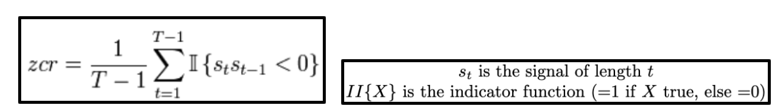


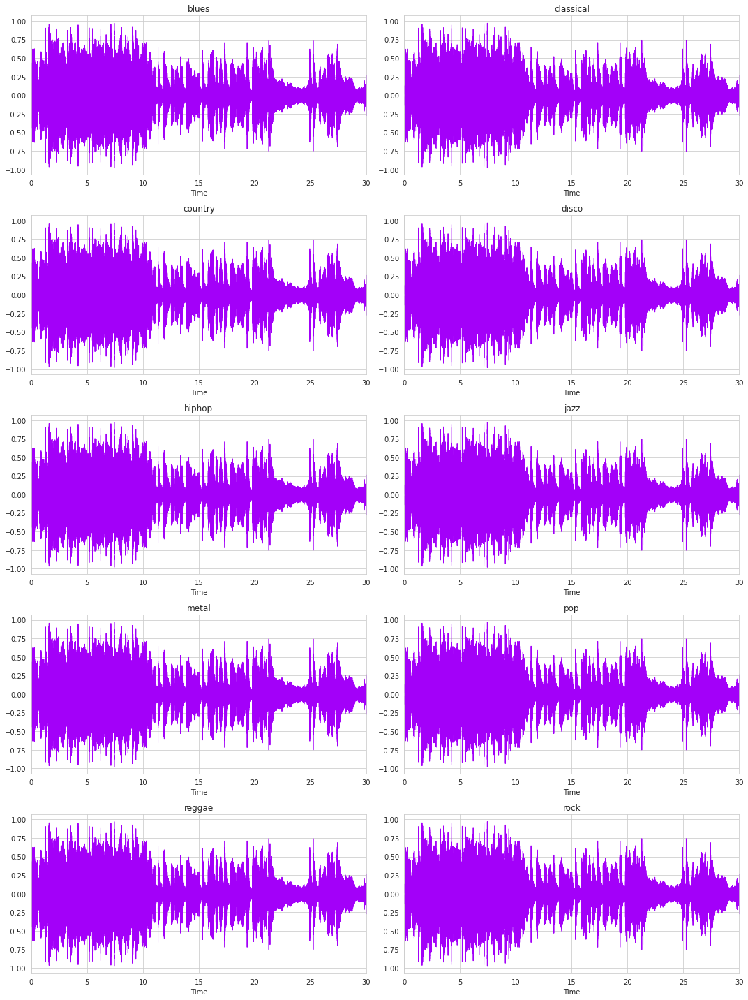

In [20]:
#Zero cross Rate Plot
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    librosa.display.waveplot(y = data, sr = sampling_rate, color = "#A300F9",ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **FT (Fourier Transforms)**

**Fourier Transform** is a function that gets a signal in the time domain as input, and outputs its decomposition into frequencies. It transforms both the x-axis (frequency) to log scale, and the “color” axis (amplitude) to Decibels, which is approx. the log scale of amplitudes.

**STFT (Short Time Fourier Transforms)** represents a signal in the time-frequency domain by computing discrete Fourier transforms (DFT) over short overlapping windows. We break down the signal into equal segments and then we take the Fourier transform of those segments.


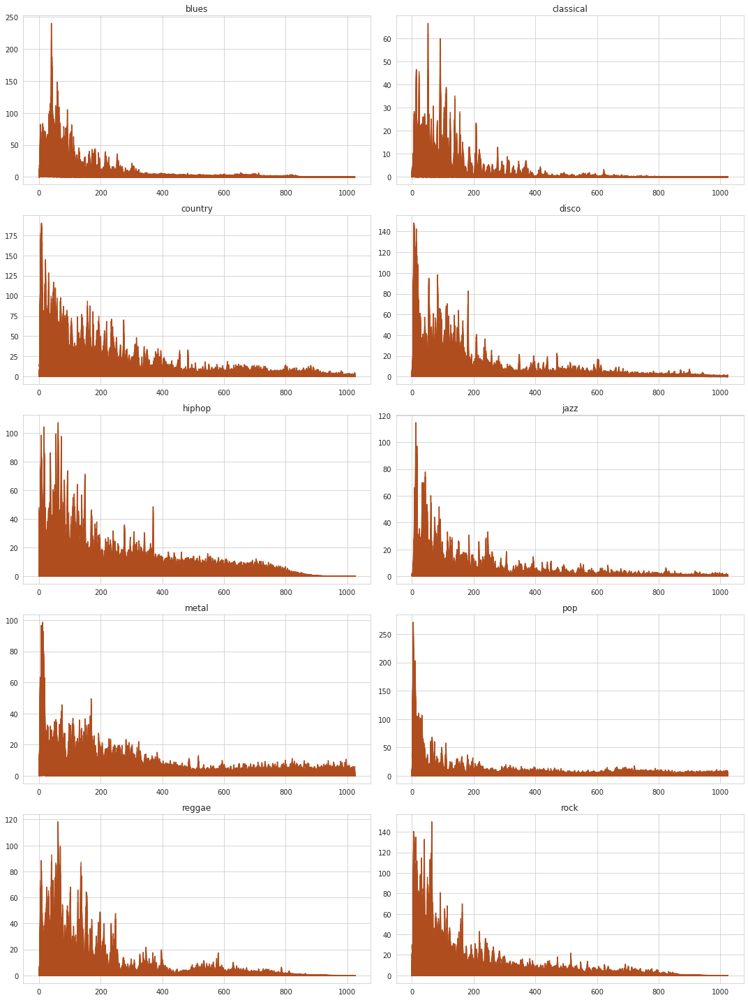

In [18]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    stft_data = np.abs(librosa.stft(y = data, n_fft = n_fft,hop_length = hop_length))
    axes[i][j].plot(stft_data,color = "#b04d1e")
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Spectogram**
A spectrogram is a detailed view of a signal that covers all three characteristics of sound. We can learn about time from the x-axis, frequencies from the y-axis, and amplitude from color. 
The louder the event the brighter the color, while silence is represented by black. 
Having three dimensions on one graph is very convenient: it allows us to track how frequencies change over time, examine the sound in all its fullness, and spot various problem areas (like noises) and patterns by sight.

We start with a signal, split it into segments, multiply each segment by the window, and then take the fourier transform of the resulting signal. When we stack these fourier transforms of each of these segments, we get the spectrogram.

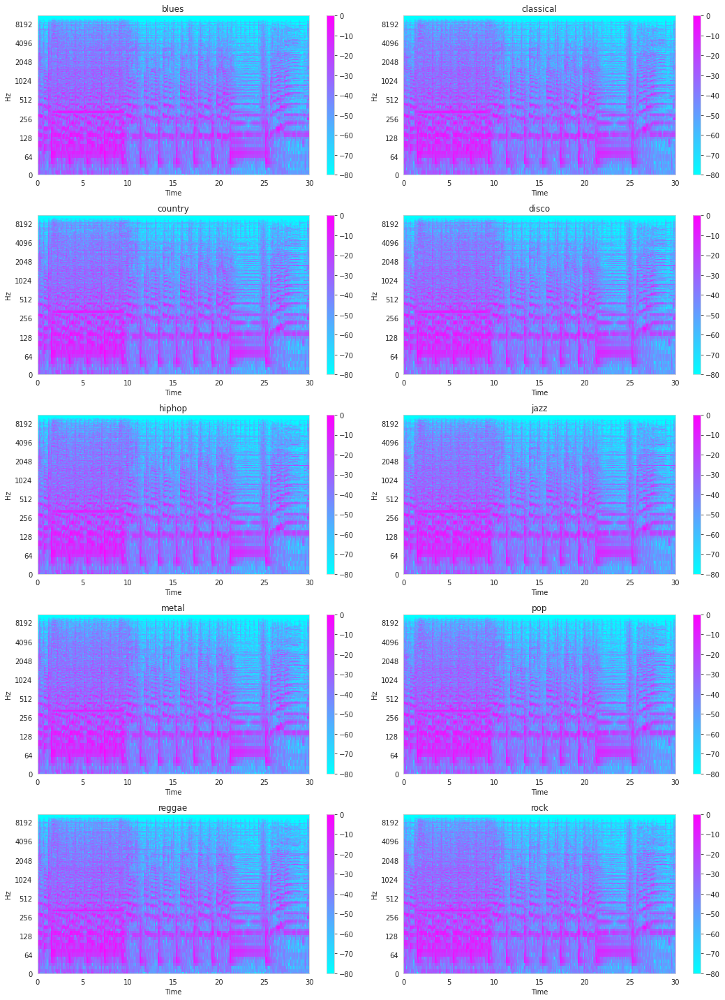

In [21]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    stft_data = np.abs(librosa.stft(y = data, n_fft = n_fft,hop_length = hop_length))
    # Convert an amplitude spectrogram to Decibels-scaled spectrogram.
    DB = librosa.amplitude_to_db(stft_data, ref = np.max)
    img = librosa.display.specshow(DB, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## Mel Spectrogram
A mel spectrogram is a spectrogram where the frequencies are converted to the mel scale. The Mel Scale is a logarithmic transformation of a signal’s frequency. The core idea of this transformation is that sounds of equal distance on the Mel Scale are perceived to be of equal distance to humans. Hence, it mimics our own perception of sound.

The transformation of frequency to mel scale is:  
m
=
1127
∗
l
n
(
1
+
f
/
700
)
 

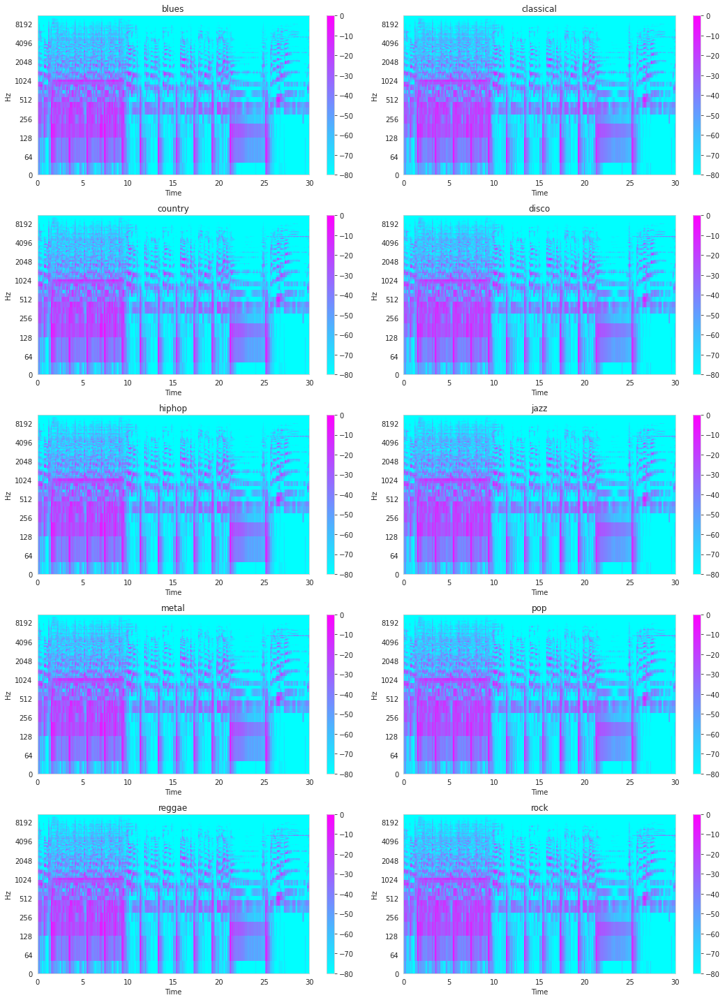

In [22]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:    
    mel_spec = librosa.feature.melspectrogram(data, sr=sampling_rate,hop_length = hop_length)
    mel_spec_db = librosa.amplitude_to_db(mel_spec, ref=np.max)
    img = librosa.display.specshow(mel_spec_db, sr = sampling_rate, hop_length = hop_length, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Mel Frequency Cepstral Coefficients**

The Mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features (usually about 10–20) which concisely describe the overall shape of a spectral envelope. It models the characteristics of the human voice.
The basic procedure to develop MFCCs is the following:

Convert from Hertz to Mel Scale
Take logarithm of Mel representation of audio
Take logarithmic magnitude and use Discrete Cosine Transformation
This result creates a spectrum over Mel frequencies as opposed to time, thus creating MFCCs
Extracting librosa's default 20 MFCC coefficients for each genre.

MFcc summarises the frequency distribution across the window size, so it is possible to analyze both the frequency and time characteristics of the sound. 

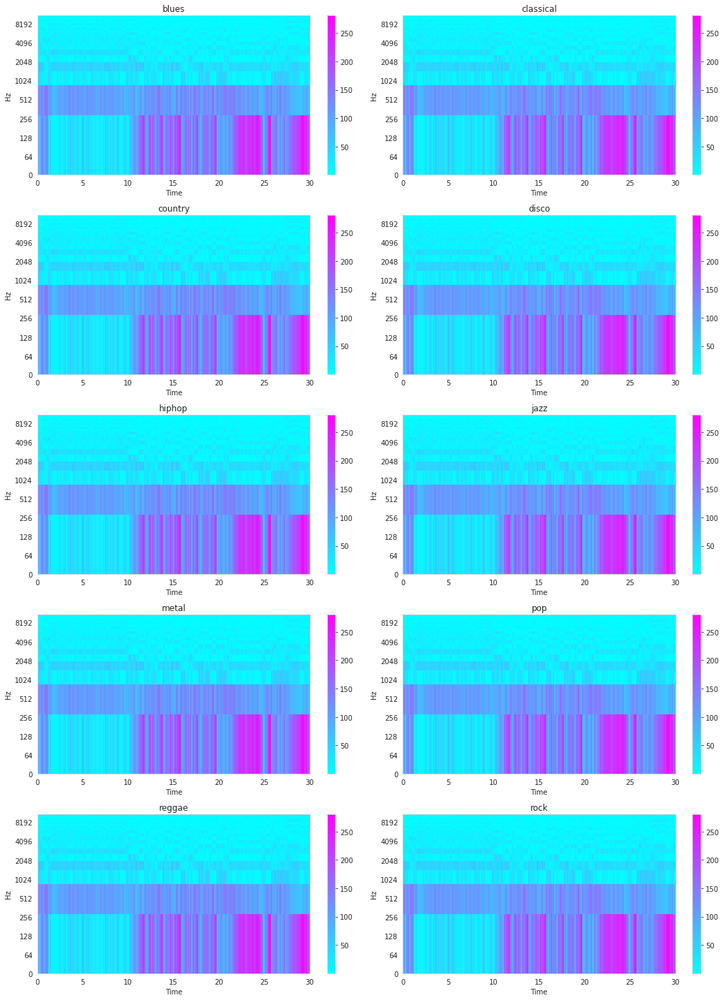

In [23]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:    
    mfcc_data = np.abs(librosa.feature.mfcc(data, sr = sampling_rate))
    img = librosa.display.specshow(mfcc_data, sr = sampling_rate, x_axis = 'time', y_axis = 'log',cmap = 'cool',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Chromagram**
Chromagram sequence of chroma features each expressing how the representation's pitch content within the time window is spread over the twelve chroma bands/pitches

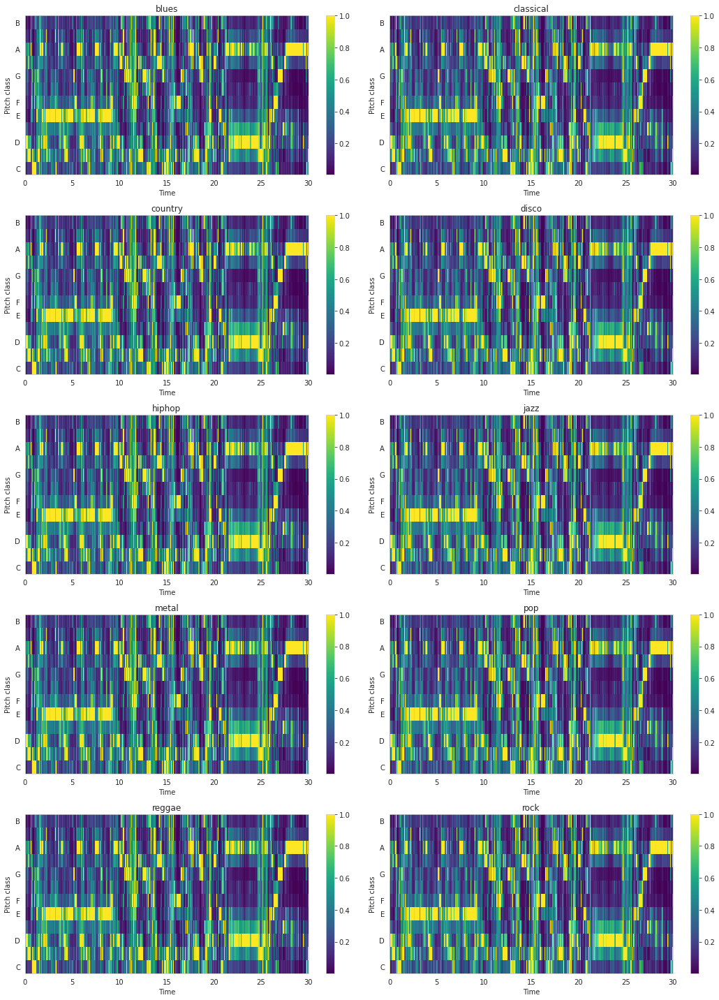

In [25]:
# Increase or decrease hop_length to change how granular we want our data to be

fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    chromagram = librosa.feature.chroma_stft(data, sr=sampling_rate, hop_length=hop_length)
    img = librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='viridis',ax=axes[i][j])
    fig.colorbar(img, ax=axes[i][j])
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Spectral Centroids**
Spectral Centroids indicates where the center of mass of the spectrum is located. Perceptually, it has a robust connection with the impression of brightness of a sound.

It is calculated as the weighted mean of the frequencies present in the signal, determined using a Fourier transform, with their magnitudes as the weights

Because the spectral centroid is a good predictor of the "brightness" of a sound, it is widely used in digital audio and music processing as an automatic measure of musical timbre (tone color or tone quality).

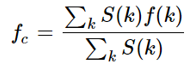

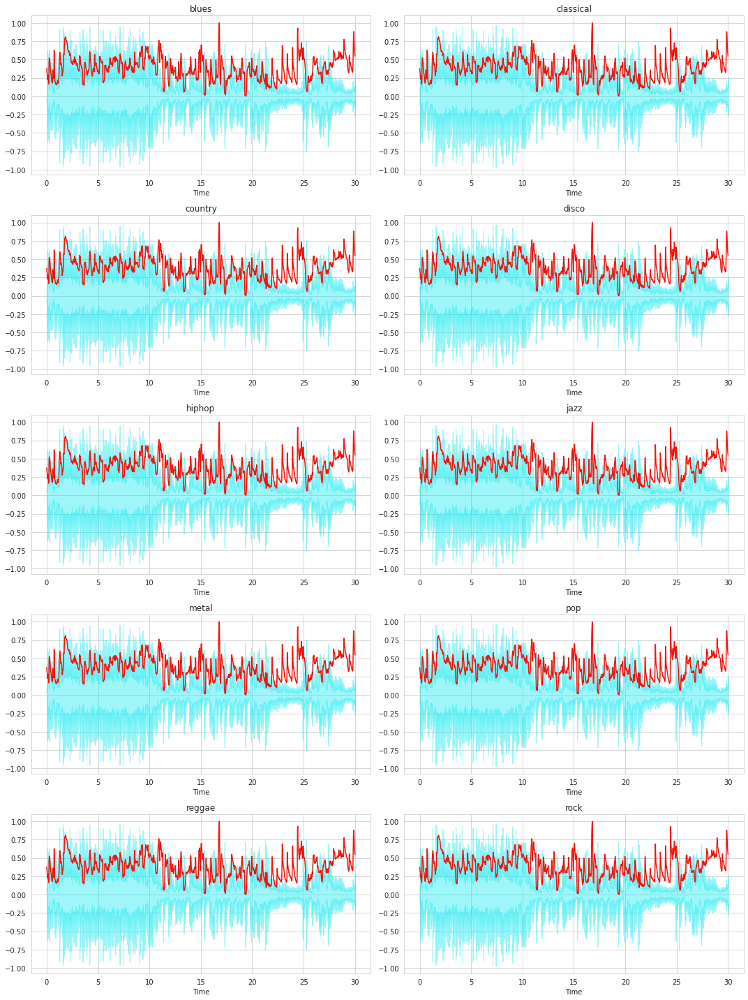

In [27]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    spectral_centroids = librosa.feature.spectral_centroid(y=data, sr=sampling_rate)[0]
    
    # Computing the time variable for visualization
    frames = range(len(spectral_centroids))

    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#0de9f1',ax=axes[i][j])
    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_centroids, axis=0), color='#f1150d')
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Spectral Bandwidth**
Spectral Bandwidth is the spectral range of interest around the centroid, that is, the variance from the spectral centroid. It measures the difference between the highest and lowest frequencies within a timeframe.

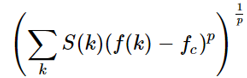

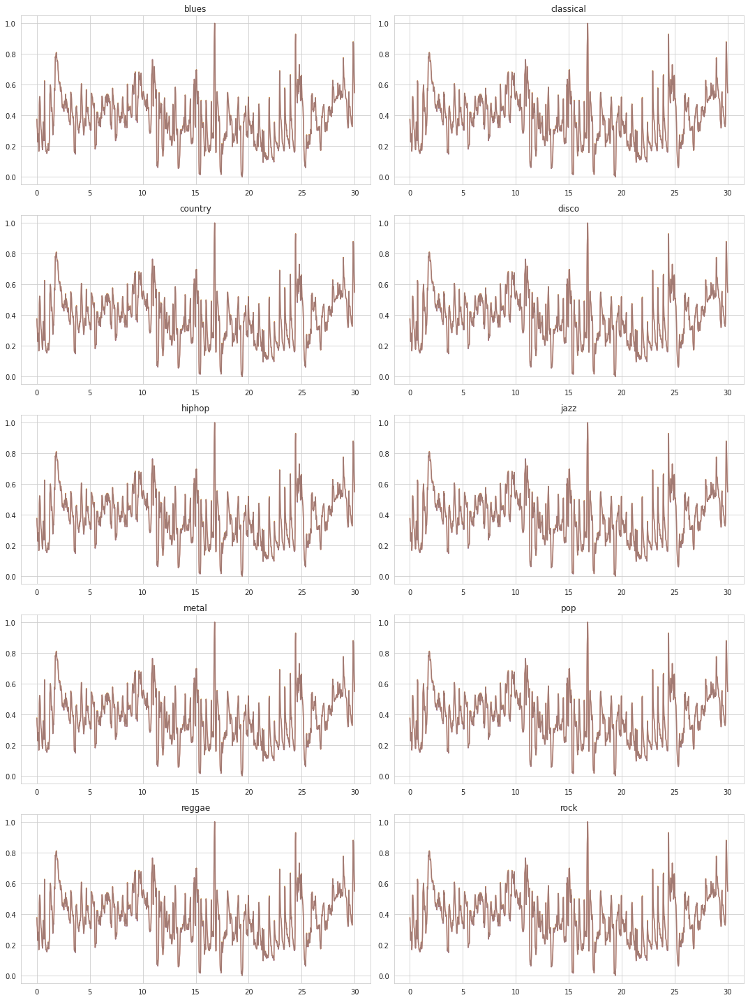

In [28]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:    
    spectral_centroids = librosa.feature.spectral_centroid(y=data, sr=sampling_rate)[0]
    spec_bw = librosa.feature.spectral_bandwidth(y=data, sr=sampling_rate)[0]
    
    # Computing the time variable for visualization
    frames = range(len(spectral_centroids))

    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    
    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_centroids, axis=0), color='#f1150d',alpha = 0.7)
    
    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_centroids + np.sqrt(spec_bw), axis=0), color='#bbf10d',alpha = 0.3)
    
    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_centroids - np.sqrt(spec_bw), axis=0), color='#0d60f1',alpha = 0.3)
  
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Tempo & Beats**
**Beat** is a regular repeating pulse that underly a musical pattern

**Tempo** is the speed at which the pattern repeats. Tempo is measured in Beats per minute

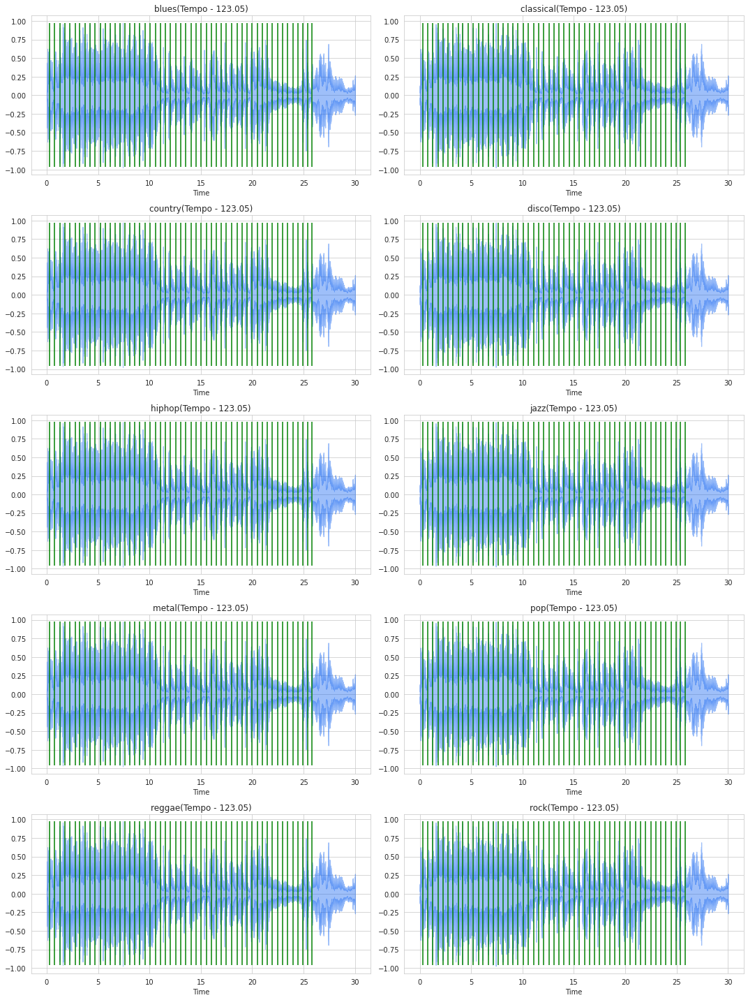

In [29]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    tempo, beat_times = librosa.beat.beat_track(y=data, sr=sampling_rate, units='time')
    librosa.display.waveshow(y = data, sr = sampling_rate, color = "#0d60f1",alpha = 0.4,ax=axes[i][j])
    axes[i][j].vlines(beat_times, np.min(data), np.max(data), color='g')
    axes[i][j].set_title(genre + "(Tempo - " + str(round(tempo,2)) + ")")
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Spectral rolloff**
Spectral rolloff is the frequency below which a specified percentage of the total spectral energy, e.g. 85%, lies

Computing the the spectral rolloff for each frame in the signal

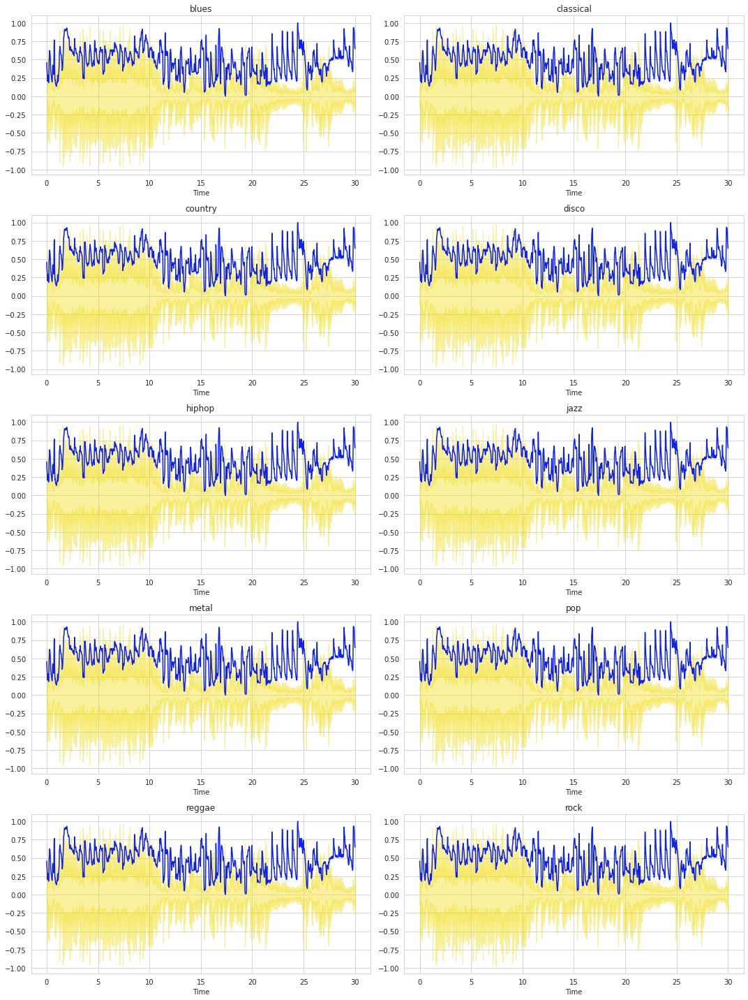

In [30]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    
    spectral_rolloff = librosa.feature.spectral_rolloff(data, sr=sampling_rate)[0]
    
    # Computing the time variable for visualization
    frames = range(len(spectral_rolloff))

    # Converts frame counts to time (seconds)
    t = librosa.frames_to_time(frames)
    
    librosa.display.waveshow(data, sr=sampling_rate, alpha=0.4, color = '#f1dc0d',ax=axes[i][j])

    axes[i][j].plot(t, sklearn.preprocessing.minmax_scale(spectral_rolloff, axis=0), color='#0d22f1')
    
    axes[i][j].set_title(genre)

    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Harmonic and Percussive Components**
Musical sounds can comprise a wide range of sound components with different acoustic qualities. In particular, we consider two broad categories of sounds: harmonic sounds and percussive sounds.

Loosely speaking, a harmonic sound is what we perceive as pitched sound, what makes us hear melodies and chords. The prototype of a harmonic sound is the acoustic realization of a sinusoid, which corresponds to a horizontal line in a spectrogram representation.

On the other hand, a percussive sound is what we perceive as a clash, a knock, a clap, or a click. The prototype of a percussive sound is the acoustic realization of an impulse, which corresponds to a vertical line in a spectrogram representation

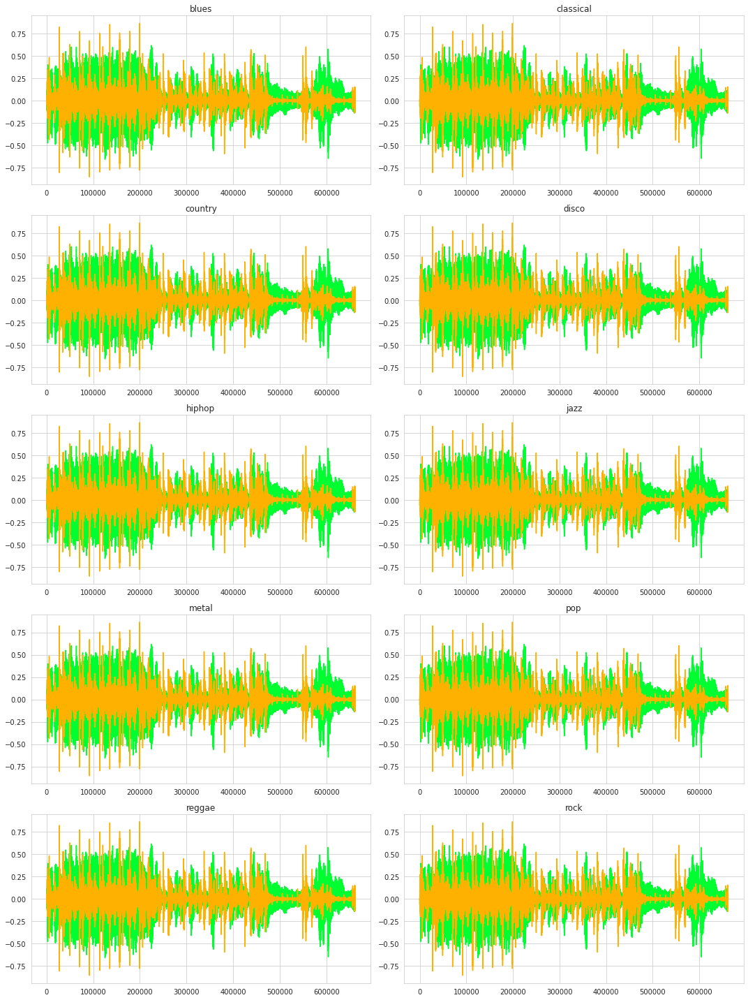

In [31]:
fig, axes= plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
i = 0
j = 0
for genre in genre_list:
    y_harm, y_perc = librosa.effects.hpss(data)
    axes[i][j].plot(y_harm, color = '#00ff31')
    axes[i][j].plot(y_perc, color = '#FFB100')
    axes[i][j].set_title(genre)
    if(j == 1):
        i = i + 1
        j = 0
    else:
        j = j + 1

plt.tight_layout()
plt.show()

## **Correlation HeatMap**

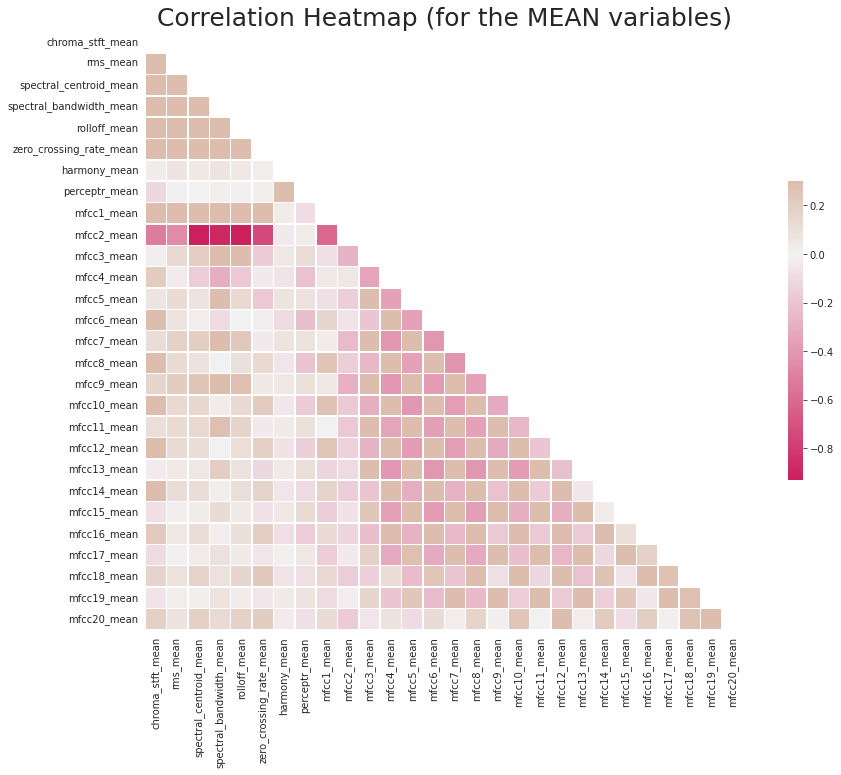

In [37]:
# Computing the Correlation Matrix
spike_cols = [col for col in df.columns if 'mean' in col]
corr = df[spike_cols].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(16, 11));

# Generate a custom diverging colormap
cmap = sns.diverging_palette(0, 25, as_cmap=True, s = 90, l = 45, n = 5)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap (for the MEAN variables)', fontsize = 25)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10);
plt.savefig("Corr Heatmap.jpg")

## **BoxPlot**

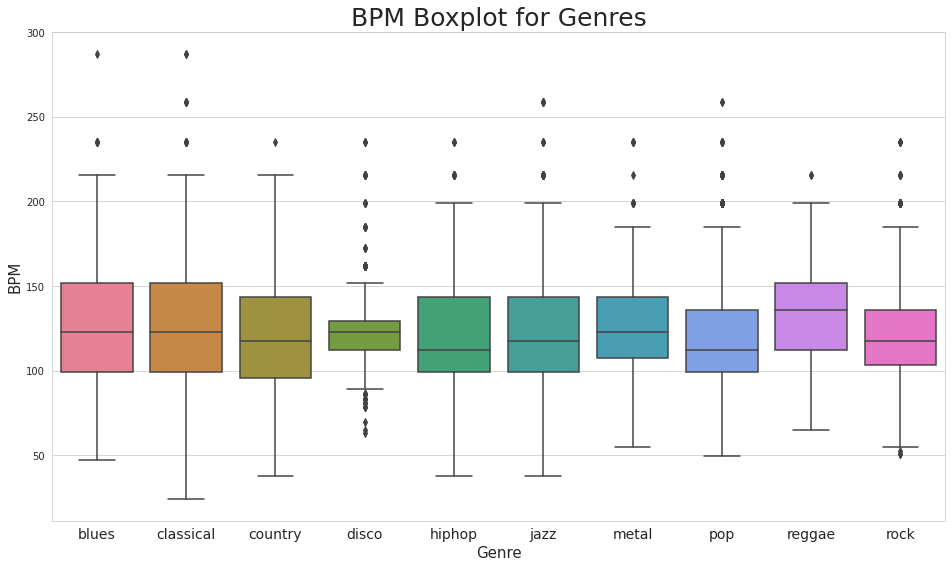

In [39]:
x = df[["label", "tempo"]]

f, ax = plt.subplots(figsize=(16, 9));
sns.boxplot(x = "label", y = "tempo", data = x, palette = 'husl');

plt.title('BPM Boxplot for Genres', fontsize = 25)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("Genre", fontsize = 15)
plt.ylabel("BPM", fontsize = 15)
plt.savefig("BPM Boxplot.jpg")

The boxplot for all the genres shows that the range of beats per minute is between 100 - 150, which is the ideal range for a human ear. The human ear stars hearing a buzz after 800-1000 beats per minute.

## Note
We couldn't take the second approach of analyzing the audio files using images because we were having issues with insufficient data (only 100 auido files) and we couldn't find a library taht would help us split one audio file of 30s to 10 audio files of 3s each. 

As we had insufficient data, the CNN was unable to train and fit efficiently and gave very unsatisfactory results.

Usually, the approach is taken by building a dataset of the chromagrams for each of the audio files and then using CNNs to analyze the image data. 

The detailed analysis of the .csv file is in an another notebook included in the zip file.